# Analysis of followers and friends in tweets



In [1]:
import numpy as np
import pandas as pd
from statsmodels.tsa.arima_process import ArmaProcess
from causalimpact import CausalImpact

from analysis.functions.datamanip import *

raw = pd.read_csv('newest_data/flair.joined.tweets.csv')

# changing date to more readable format
raw['created_at'] = pd.to_datetime(raw['created_at'])

# getting seperated date and time columns
raw['date'] = raw['created_at'].dt.date
raw['time'] = raw['created_at'].dt.time
raw['hour'] = raw['created_at'].dt.hour

# changing na to None
raw = raw.fillna('None')

# only 4 samples that have no sentiment
raw = raw[raw['sentiment'] != 'None']

raw['ogtext'] = raw['cleantext']

raw.head()

,id_str,created_at,follower_count,friends_count,statefips,countyfips,countyname,is_urban,ogtext,cleantext,mentions,hashtags,pos,ner,sentiment,sent_confidence,date,time,hour
0,id:1226763665036075008,2020-02-10 07:03:44+00:00,270.0,539.0,32.0,3.0,Clark,1,have mocha avoid coronavirus airport,have mocha avoid coronavirus airport,None,None,"[['having', 'VBG'], ['a', 'DT'], ['mocha', 'NN...",None,POSITIVE,0.940228,2020-02-10,07:03:44,7
1,id:1226763937317818368,2020-02-10 07:04:49+00:00,199.0,216.0,36.0,81.0,Queens,1,heart beat china,heart beat china,['linsapna'],None,"[['our', 'PRP$'], ['hearts', 'NNS'], ['beat', ...",None,POSITIVE,0.872616,2020-02-10,07:04:49,7
2,id:1226764107958734851,2020-02-10 07:05:30+00:00,235.0,130.0,4.0,13.0,Maricopa,1,people stop sister street fun wearing mask s a...,people stop sister street fun wearing mask s a...,None,None,"[['people', 'NNS'], ['stop', 'VBP'], ['my', 'P...",None,POSITIVE,0.925717,2020-02-10,07:05:30,7
3,id:1226765442548719616,2020-02-10 07:10:48+00:00,60008.0,51176.0,5.0,119.0,Pulaski,0,coronavirus death toll surpass number fatal...,coronavirus death toll surpass number fatal...,None,None,"[['coronavirus', 'NN'], ['death', 'NN'], ['tol...",None,NEGATIVE,0.994157,2020-02-10,07:10:48,7
4,id:1226765540229861376,2020-02-10 07:11:11+00:00,60008.0,51176.0,5.0,119.0,Pulaski,0,coronavirus case aboard japanese cruise shi...,coronavirus case aboard japanese cruise shi...,None,None,"[['coronavirus', 'NN'], ['cases', 'NNS'], ['ab...",None,NEGATIVE,0.998726,2020-02-10,07:11:11,7


# Mean and standard deviation of followers

In [2]:
print(raw['follower_count'].mean(), raw['follower_count'].std())

3952.5904718536726 36014.691649341185


# Mean and standard deviation of friends

In [3]:
print(raw['friends_count'].mean(), raw['friends_count'].std())

2159.5024677355946 9451.043199394477


# scatter of followers x friends

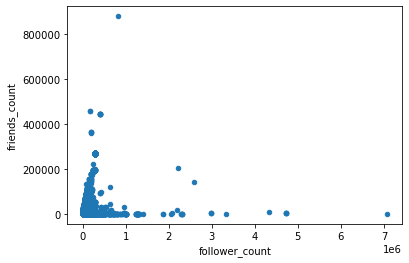

In [4]:
raw.plot.scatter(x='follower_count', y='friends_count')

# followers/(1+friends) stats

In [5]:
raw['follow/friends'] = raw['follower_count'] / (1+raw['friends_count'])

print(f"median: {raw['follow/friends'].median()}, mean: {raw['follow/friends'].mean()}, stand dev: {raw['follow/friends'].std()}")

median: 0.7987967914438503, mean: 9.482318305408349, stand dev: 465.4637486681976


# number of tweets with > mean+2*std 

from only subset of geo-located tweets

In [6]:
data = raw[raw['follow/friends'] < raw['follow/friends'].mean() + 2*raw['follow/friends'].std()]

len(raw.index) - len(raw[raw['follow/friends'] < raw['follow/friends'].mean() + 2*raw['follow/friends'].std()].index)

470